In [ ]:
# Cell 1: Install necessary packages
!pip install torch torchvision scikit-image tqdm matplotlib -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 120.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 94.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 64.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 99.8 MB/s eta 0:00:00


In [ ]:
# Cell 2: Import libraries and set up the environment
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import ToTensor
import torch.nn.functional as F

import numpy as np
from PIL import Image, ImageFilter
import os
import glob
from tqdm.notebook import tqdm
import time
import matplotlib.pyplot as plt
import subprocess

from skimage.metrics import structural_similarity

# --- Setup Device and Seeds for Reproducibility ---
torch.manual_seed(42)
np.random.seed(42)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


In [ ]:
# Cell 3: Download and Extract Dataset
TRAIN_PATH = 'BSR/BSDS500/data/images/train/'
TEST_PATH = 'BSR/BSDS500/data/images/test/'

if not os.path.exists('BSR'):
    print("--- Downloading BSD500 dataset ---")
    # These shell commands work in Colab/Jupyter
    !wget -q https://www2.eecs.berkeley.edu/Research/Projects/CS/vision/grouping/BSR/BSR_bsds500.tgz
    !tar -xzf BSR_bsds500.tgz
    print("Dataset extracted successfully.")
else:
    print("Dataset already exists.")


--- Downloading BSD500 dataset ---
Dataset extracted successfully.


In [ ]:
# Cell 4: Define Dataset, Model, and Helper Functions

class BSD500RestorationDataset(Dataset):
    """Custom Dataset for image restoration with added blur."""
    def __init__(self, image_dir, patch_size=256, scale_factor=2, blur_radius=1):
        self.image_paths = sorted(glob.glob(os.path.join(image_dir, "*.jpg")))
        self.patch_size = patch_size
        self.scale_factor = scale_factor
        self.blur_radius = blur_radius
        self.to_tensor = ToTensor()
        print(f"Found {len(self.image_paths)} images in {image_dir}.")
        if self.blur_radius > 0:
            print(f"-> Applying Gaussian Blur with radius={self.blur_radius} to inputs.")

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        hr_image = Image.open(self.image_paths[idx]).convert('RGB')
        w, h = hr_image.size
        if w < self.patch_size or h < self.patch_size:
             hr_image = hr_image.resize((self.patch_size, self.patch_size), Image.BICUBIC)
             w, h = hr_image.size
        rand_w, rand_h = np.random.randint(0, w - self.patch_size + 1), np.random.randint(0, h - self.patch_size + 1)
        hr_patch = hr_image.crop((rand_w, rand_h, rand_w + self.patch_size, rand_h + self.patch_size))

        lr_w, lr_h = self.patch_size // self.scale_factor, self.patch_size // self.scale_factor

        # Degrade: Downsample -> Blur -> Upsample
        degraded_patch = hr_patch.resize((lr_w, lr_h), Image.BICUBIC)
        if self.blur_radius > 0:
            degraded_patch = degraded_patch.filter(ImageFilter.GaussianBlur(radius=self.blur_radius))
        degraded_patch = degraded_patch.resize((self.patch_size, self.patch_size), Image.BICUBIC)

        hr_tensor, degraded_tensor = self.to_tensor(hr_patch), self.to_tensor(degraded_patch)
        return {'lr': degraded_tensor, 'hr': hr_tensor}

def to_numpy_image(tensor):
    """Convert a tensor to a numpy image for visualization."""
    img = tensor.squeeze(0).cpu().detach().numpy()
    img = np.transpose(img, (1, 2, 0))
    return np.clip(img, 0, 1)

def calculate_ssim(img1_tensor, img2_tensor):
    """Calculate SSIM between two tensors."""
    img1, img2 = to_numpy_image(img1_tensor), to_numpy_image(img2_tensor)
    # The 'multichannel' argument is deprecated; use 'channel_axis' instead
    win_size = min(min(img1.shape[0], img1.shape[1]), 7)
    if win_size < 3: return 0.0
    if win_size % 2 == 0: win_size -=1
    return structural_similarity(img1, img2, win_size=win_size, channel_axis=-1, data_range=1.0)

def calculate_psnr(img1_tensor, img2_tensor):
    """Calculate PSNR between two tensors."""
    mse = F.mse_loss(img1_tensor, img2_tensor)
    return 20 * torch.log10(1.0 / torch.sqrt(mse)).item() if mse > 0 else float('inf')

class ResBlock(nn.Module):
    """A simple residual block."""
    def __init__(self, channels):
        super(ResBlock, self).__init__()
        self.convs = nn.Sequential(nn.Conv2d(channels, channels, 3, 1, 1), nn.ReLU(True), nn.Conv2d(channels, channels, 3, 1, 1))
    def forward(self, x): return x + self.convs(x)

class HIDEModel(nn.Module):
    """The HIDE model architecture (U-Net with residual blocks)."""
    def __init__(self, in_channels=3, out_channels=3, n_feats=64, n_resblocks=8):
        super(HIDEModel, self).__init__()
        self.conv_in = nn.Conv2d(in_channels, n_feats, 3, 1, 1)
        self.encoder_l1 = nn.Sequential(*[ResBlock(n_feats) for _ in range(n_resblocks)])
        self.down1 = nn.Conv2d(n_feats, n_feats*2, 3, 2, 1)
        self.encoder_l2 = nn.Sequential(*[ResBlock(n_feats*2) for _ in range(n_resblocks)])
        self.down2 = nn.Conv2d(n_feats*2, n_feats*4, 3, 2, 1)
        self.bottleneck = nn.Sequential(*[ResBlock(n_feats*4) for _ in range(n_resblocks)])
        self.up2 = nn.ConvTranspose2d(n_feats*4, n_feats*2, 4, 2, 1)
        self.decoder_l2 = nn.Sequential(nn.Conv2d(n_feats*4, n_feats*2, 1), *[ResBlock(n_feats*2) for _ in range(n_resblocks)])
        self.up1 = nn.ConvTranspose2d(n_feats*2, n_feats, 4, 2, 1)
        self.decoder_l1 = nn.Sequential(nn.Conv2d(n_feats*2, n_feats, 1), *[ResBlock(n_feats) for _ in range(n_resblocks)])
        self.conv_out = nn.Conv2d(n_feats, out_channels, 3, 1, 1)
    def forward(self, x):
        residual = x
        feat_in = self.conv_in(x)
        feat_l1 = self.encoder_l1(feat_in)
        feat_l2 = self.encoder_l2(self.down1(feat_l1))
        bottleneck_out = self.bottleneck(self.down2(feat_l2))
        feat_decode2 = self.decoder_l2(torch.cat([self.up2(bottleneck_out), feat_l2], 1))
        feat_decode1 = self.decoder_l1(torch.cat([self.up1(feat_decode2), feat_l1], 1))
        return self.conv_out(feat_decode1) + residual

print("All classes and helper functions defined.")

All classes and helper functions defined.


In [ ]:
# Cell 5: Teacher Model Training
print("\n--- Training Teacher Model (8 ResBlocks) ---")
teacher_model_path = "teacher_model_blurred.pth"
teacher_model = HIDEModel(n_feats=64, n_resblocks=8).to(device)
optimizer = optim.Adam(teacher_model.parameters(), lr=1e-4)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=25, gamma=0.5)
criterion = nn.L1Loss()
num_epochs_teacher = 75 # Increased epochs

# Create dataloaders
train_dataset = BSD500RestorationDataset(TRAIN_PATH, scale_factor=2, blur_radius=1)
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, num_workers=2, pin_memory=True)

start_time = time.time()
for epoch in range(num_epochs_teacher):
    teacher_model.train()
    epoch_loss = 0
    progress_bar = tqdm(train_loader, desc=f"Teacher Epoch {epoch+1}/{num_epochs_teacher}", leave=False)
    for batch in progress_bar:
        degraded, sharp = batch['lr'].to(device), batch['hr'].to(device)
        optimizer.zero_grad()
        loss = criterion(teacher_model(degraded), sharp)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
    scheduler.step()
    print(f"Teacher Epoch [{epoch+1}/{num_epochs_teacher}], Avg Loss: {epoch_loss/len(train_loader):.6f}, LR: {scheduler.get_last_lr()[0]:.1e}")
print(f"--- Teacher Training Finished in {(time.time() - start_time)/60:.2f} minutes ---")
torch.save(teacher_model.state_dict(), teacher_model_path)
print(f"Teacher model saved to {teacher_model_path}")


--- Training Teacher Model (8 ResBlocks) ---
Found 200 images in BSR/BSDS500/data/images/train/.
-> Applying Gaussian Blur with radius=1 to inputs.


Teacher Epoch 1/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [1/75], Avg Loss: 0.050596, LR: 1.0e-04


Teacher Epoch 2/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [2/75], Avg Loss: 0.039656, LR: 1.0e-04


Teacher Epoch 3/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [3/75], Avg Loss: 0.037701, LR: 1.0e-04


Teacher Epoch 4/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [4/75], Avg Loss: 0.035019, LR: 1.0e-04


Teacher Epoch 5/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [5/75], Avg Loss: 0.032352, LR: 1.0e-04


Teacher Epoch 6/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [6/75], Avg Loss: 0.030253, LR: 1.0e-04


Teacher Epoch 7/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [7/75], Avg Loss: 0.030007, LR: 1.0e-04


Teacher Epoch 8/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [8/75], Avg Loss: 0.029375, LR: 1.0e-04


Teacher Epoch 9/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [9/75], Avg Loss: 0.028744, LR: 1.0e-04


Teacher Epoch 10/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [10/75], Avg Loss: 0.028047, LR: 1.0e-04


Teacher Epoch 11/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [11/75], Avg Loss: 0.027484, LR: 1.0e-04


Teacher Epoch 12/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [12/75], Avg Loss: 0.027403, LR: 1.0e-04


Teacher Epoch 13/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [13/75], Avg Loss: 0.026955, LR: 1.0e-04


Teacher Epoch 14/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [14/75], Avg Loss: 0.026895, LR: 1.0e-04


Teacher Epoch 15/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [15/75], Avg Loss: 0.027150, LR: 1.0e-04


Teacher Epoch 16/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [16/75], Avg Loss: 0.026593, LR: 1.0e-04


Teacher Epoch 17/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [17/75], Avg Loss: 0.027315, LR: 1.0e-04


Teacher Epoch 18/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [18/75], Avg Loss: 0.026338, LR: 1.0e-04


Teacher Epoch 19/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [19/75], Avg Loss: 0.026431, LR: 1.0e-04


Teacher Epoch 20/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [20/75], Avg Loss: 0.026641, LR: 1.0e-04


Teacher Epoch 21/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [21/75], Avg Loss: 0.026754, LR: 1.0e-04


Teacher Epoch 22/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [22/75], Avg Loss: 0.026023, LR: 1.0e-04


Teacher Epoch 23/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [23/75], Avg Loss: 0.026237, LR: 1.0e-04


Teacher Epoch 24/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [24/75], Avg Loss: 0.026467, LR: 1.0e-04


Teacher Epoch 25/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [25/75], Avg Loss: 0.026281, LR: 5.0e-05


Teacher Epoch 26/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [26/75], Avg Loss: 0.026449, LR: 5.0e-05


Teacher Epoch 27/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [27/75], Avg Loss: 0.026008, LR: 5.0e-05


Teacher Epoch 28/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [28/75], Avg Loss: 0.026056, LR: 5.0e-05


Teacher Epoch 29/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [29/75], Avg Loss: 0.025855, LR: 5.0e-05


Teacher Epoch 30/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [30/75], Avg Loss: 0.026079, LR: 5.0e-05


Teacher Epoch 31/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [31/75], Avg Loss: 0.025860, LR: 5.0e-05


Teacher Epoch 32/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [32/75], Avg Loss: 0.025686, LR: 5.0e-05


Teacher Epoch 33/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [33/75], Avg Loss: 0.026024, LR: 5.0e-05


Teacher Epoch 34/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [34/75], Avg Loss: 0.026204, LR: 5.0e-05


Teacher Epoch 35/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [35/75], Avg Loss: 0.025598, LR: 5.0e-05


Teacher Epoch 36/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [36/75], Avg Loss: 0.025511, LR: 5.0e-05


Teacher Epoch 37/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [37/75], Avg Loss: 0.026044, LR: 5.0e-05


Teacher Epoch 38/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [38/75], Avg Loss: 0.025808, LR: 5.0e-05


Teacher Epoch 39/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [39/75], Avg Loss: 0.025571, LR: 5.0e-05


Teacher Epoch 40/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [40/75], Avg Loss: 0.025692, LR: 5.0e-05


Teacher Epoch 41/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [41/75], Avg Loss: 0.025684, LR: 5.0e-05


Teacher Epoch 42/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [42/75], Avg Loss: 0.025715, LR: 5.0e-05


Teacher Epoch 43/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [43/75], Avg Loss: 0.025523, LR: 5.0e-05


Teacher Epoch 44/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [44/75], Avg Loss: 0.025519, LR: 5.0e-05


Teacher Epoch 45/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [45/75], Avg Loss: 0.025781, LR: 5.0e-05


Teacher Epoch 46/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [46/75], Avg Loss: 0.025595, LR: 5.0e-05


Teacher Epoch 47/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [47/75], Avg Loss: 0.025469, LR: 5.0e-05


Teacher Epoch 48/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [48/75], Avg Loss: 0.025705, LR: 5.0e-05


Teacher Epoch 49/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [49/75], Avg Loss: 0.025615, LR: 5.0e-05


Teacher Epoch 50/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [50/75], Avg Loss: 0.025367, LR: 2.5e-05


Teacher Epoch 51/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [51/75], Avg Loss: 0.025126, LR: 2.5e-05


Teacher Epoch 52/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [52/75], Avg Loss: 0.025462, LR: 2.5e-05


Teacher Epoch 53/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [53/75], Avg Loss: 0.025575, LR: 2.5e-05


Teacher Epoch 54/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [54/75], Avg Loss: 0.025118, LR: 2.5e-05


Teacher Epoch 55/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [55/75], Avg Loss: 0.025233, LR: 2.5e-05


Teacher Epoch 56/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [56/75], Avg Loss: 0.025598, LR: 2.5e-05


Teacher Epoch 57/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [57/75], Avg Loss: 0.025642, LR: 2.5e-05


Teacher Epoch 58/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [58/75], Avg Loss: 0.025351, LR: 2.5e-05


Teacher Epoch 59/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [59/75], Avg Loss: 0.025611, LR: 2.5e-05


Teacher Epoch 60/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [60/75], Avg Loss: 0.025153, LR: 2.5e-05


Teacher Epoch 61/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [61/75], Avg Loss: 0.025259, LR: 2.5e-05


Teacher Epoch 62/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [62/75], Avg Loss: 0.025266, LR: 2.5e-05


Teacher Epoch 63/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [63/75], Avg Loss: 0.025100, LR: 2.5e-05


Teacher Epoch 64/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [64/75], Avg Loss: 0.024966, LR: 2.5e-05


Teacher Epoch 65/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [65/75], Avg Loss: 0.024975, LR: 2.5e-05


Teacher Epoch 66/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [66/75], Avg Loss: 0.024740, LR: 2.5e-05


Teacher Epoch 67/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [67/75], Avg Loss: 0.025453, LR: 2.5e-05


Teacher Epoch 68/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [68/75], Avg Loss: 0.025001, LR: 2.5e-05


Teacher Epoch 69/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [69/75], Avg Loss: 0.025220, LR: 2.5e-05


Teacher Epoch 70/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [70/75], Avg Loss: 0.024995, LR: 2.5e-05


Teacher Epoch 71/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [71/75], Avg Loss: 0.025210, LR: 2.5e-05


Teacher Epoch 72/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [72/75], Avg Loss: 0.024672, LR: 2.5e-05


Teacher Epoch 73/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [73/75], Avg Loss: 0.025590, LR: 2.5e-05


Teacher Epoch 74/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [74/75], Avg Loss: 0.025239, LR: 2.5e-05


Teacher Epoch 75/75:   0%|          | 0/25 [00:00<?, ?it/s]

Teacher Epoch [75/75], Avg Loss: 0.024794, LR: 1.3e-05
--- Teacher Training Finished in 61.91 minutes ---
Teacher model saved to teacher_model_blurred.pth


In [ ]:
# Cell 6: Student Model Training (Knowledge Distillation)
print("\n--- Training Student Model (3 ResBlocks) via Distillation ---")
teacher_model.eval() # Freeze the teacher model

student_model = HIDEModel(n_feats=64, n_resblocks=3).to(device)
student_model_path = "student_model_blurred.pth"
optimizer = optim.Adam(student_model.parameters(), lr=1e-4)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=25, gamma=0.5)
alpha = 0.75 # Distillation loss weight
num_epochs_student = 75

start_time = time.time()
for epoch in range(num_epochs_student):
    student_model.train()
    epoch_loss = 0
    progress_bar = tqdm(train_loader, desc=f"Student Epoch {epoch+1}/{num_epochs_student}", leave=False)
    for batch in progress_bar:
        degraded, sharp = batch['lr'].to(device), batch['hr'].to(device)
        with torch.no_grad():
            teacher_pred = teacher_model(degraded)

        student_pred = student_model(degraded)
        loss = alpha * criterion(student_pred, teacher_pred) + (1 - alpha) * criterion(student_pred, sharp)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
    scheduler.step()
    print(f"Student Epoch [{epoch+1}/{num_epochs_student}], Avg Loss: {epoch_loss/len(train_loader):.6f}, LR: {scheduler.get_last_lr()[0]:.1e}")
print(f"--- Distillation Training Finished in {(time.time() - start_time)/60:.2f} minutes ---")
torch.save(student_model.state_dict(), student_model_path)
print(f"Student model saved to {student_model_path}")


--- Training Student Model (3 ResBlocks) via Distillation ---


Student Epoch 1/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [1/75], Avg Loss: 0.040691, LR: 1.0e-04


Student Epoch 2/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [2/75], Avg Loss: 0.032505, LR: 1.0e-04


Student Epoch 3/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [3/75], Avg Loss: 0.029996, LR: 1.0e-04


Student Epoch 4/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [4/75], Avg Loss: 0.028070, LR: 1.0e-04


Student Epoch 5/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [5/75], Avg Loss: 0.024664, LR: 1.0e-04


Student Epoch 6/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [6/75], Avg Loss: 0.022092, LR: 1.0e-04


Student Epoch 7/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [7/75], Avg Loss: 0.019677, LR: 1.0e-04


Student Epoch 8/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [8/75], Avg Loss: 0.018195, LR: 1.0e-04


Student Epoch 9/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [9/75], Avg Loss: 0.016630, LR: 1.0e-04


Student Epoch 10/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [10/75], Avg Loss: 0.015618, LR: 1.0e-04


Student Epoch 11/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [11/75], Avg Loss: 0.014999, LR: 1.0e-04


Student Epoch 12/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [12/75], Avg Loss: 0.014099, LR: 1.0e-04


Student Epoch 13/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [13/75], Avg Loss: 0.013878, LR: 1.0e-04


Student Epoch 14/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [14/75], Avg Loss: 0.013188, LR: 1.0e-04


Student Epoch 15/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [15/75], Avg Loss: 0.013338, LR: 1.0e-04


Student Epoch 16/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [16/75], Avg Loss: 0.012903, LR: 1.0e-04


Student Epoch 17/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [17/75], Avg Loss: 0.012397, LR: 1.0e-04


Student Epoch 18/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [18/75], Avg Loss: 0.012123, LR: 1.0e-04


Student Epoch 19/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [19/75], Avg Loss: 0.012116, LR: 1.0e-04


Student Epoch 20/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [20/75], Avg Loss: 0.011632, LR: 1.0e-04


Student Epoch 21/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [21/75], Avg Loss: 0.011701, LR: 1.0e-04


Student Epoch 22/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [22/75], Avg Loss: 0.011295, LR: 1.0e-04


Student Epoch 23/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [23/75], Avg Loss: 0.011230, LR: 1.0e-04


Student Epoch 24/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [24/75], Avg Loss: 0.011120, LR: 1.0e-04


Student Epoch 25/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [25/75], Avg Loss: 0.010785, LR: 5.0e-05


Student Epoch 26/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [26/75], Avg Loss: 0.010641, LR: 5.0e-05


Student Epoch 27/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [27/75], Avg Loss: 0.010327, LR: 5.0e-05


Student Epoch 28/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [28/75], Avg Loss: 0.010471, LR: 5.0e-05


Student Epoch 29/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [29/75], Avg Loss: 0.010262, LR: 5.0e-05


Student Epoch 30/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [30/75], Avg Loss: 0.010351, LR: 5.0e-05


Student Epoch 31/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [31/75], Avg Loss: 0.010140, LR: 5.0e-05


Student Epoch 32/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [32/75], Avg Loss: 0.010186, LR: 5.0e-05


Student Epoch 33/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [33/75], Avg Loss: 0.010105, LR: 5.0e-05


Student Epoch 34/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [34/75], Avg Loss: 0.010058, LR: 5.0e-05


Student Epoch 35/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [35/75], Avg Loss: 0.009996, LR: 5.0e-05


Student Epoch 36/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [36/75], Avg Loss: 0.009903, LR: 5.0e-05


Student Epoch 37/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [37/75], Avg Loss: 0.009704, LR: 5.0e-05


Student Epoch 38/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [38/75], Avg Loss: 0.009880, LR: 5.0e-05


Student Epoch 39/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [39/75], Avg Loss: 0.009681, LR: 5.0e-05


Student Epoch 40/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [40/75], Avg Loss: 0.009657, LR: 5.0e-05


Student Epoch 41/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [41/75], Avg Loss: 0.009871, LR: 5.0e-05


Student Epoch 42/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [42/75], Avg Loss: 0.009866, LR: 5.0e-05


Student Epoch 43/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [43/75], Avg Loss: 0.009595, LR: 5.0e-05


Student Epoch 44/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [44/75], Avg Loss: 0.009553, LR: 5.0e-05


Student Epoch 45/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [45/75], Avg Loss: 0.009553, LR: 5.0e-05


Student Epoch 46/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [46/75], Avg Loss: 0.009424, LR: 5.0e-05


Student Epoch 47/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [47/75], Avg Loss: 0.009513, LR: 5.0e-05


Student Epoch 48/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [48/75], Avg Loss: 0.009534, LR: 5.0e-05


Student Epoch 49/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [49/75], Avg Loss: 0.009328, LR: 5.0e-05


Student Epoch 50/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [50/75], Avg Loss: 0.009589, LR: 2.5e-05


Student Epoch 51/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [51/75], Avg Loss: 0.009313, LR: 2.5e-05


Student Epoch 52/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [52/75], Avg Loss: 0.009187, LR: 2.5e-05


Student Epoch 53/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [53/75], Avg Loss: 0.009146, LR: 2.5e-05


Student Epoch 54/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [54/75], Avg Loss: 0.009170, LR: 2.5e-05


Student Epoch 55/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [55/75], Avg Loss: 0.009070, LR: 2.5e-05


Student Epoch 56/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [56/75], Avg Loss: 0.009056, LR: 2.5e-05


Student Epoch 57/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [57/75], Avg Loss: 0.009167, LR: 2.5e-05


Student Epoch 58/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [58/75], Avg Loss: 0.009113, LR: 2.5e-05


Student Epoch 59/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [59/75], Avg Loss: 0.009158, LR: 2.5e-05


Student Epoch 60/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [60/75], Avg Loss: 0.009301, LR: 2.5e-05


Student Epoch 61/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [61/75], Avg Loss: 0.009124, LR: 2.5e-05


Student Epoch 62/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [62/75], Avg Loss: 0.009069, LR: 2.5e-05


Student Epoch 63/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [63/75], Avg Loss: 0.008911, LR: 2.5e-05


Student Epoch 64/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [64/75], Avg Loss: 0.009015, LR: 2.5e-05


Student Epoch 65/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [65/75], Avg Loss: 0.009060, LR: 2.5e-05


Student Epoch 66/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [66/75], Avg Loss: 0.009053, LR: 2.5e-05


Student Epoch 67/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [67/75], Avg Loss: 0.009073, LR: 2.5e-05


Student Epoch 68/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [68/75], Avg Loss: 0.008818, LR: 2.5e-05


Student Epoch 69/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [69/75], Avg Loss: 0.008948, LR: 2.5e-05


Student Epoch 70/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [70/75], Avg Loss: 0.009058, LR: 2.5e-05


Student Epoch 71/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [71/75], Avg Loss: 0.008985, LR: 2.5e-05


Student Epoch 72/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [72/75], Avg Loss: 0.008915, LR: 2.5e-05


Student Epoch 73/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [73/75], Avg Loss: 0.009002, LR: 2.5e-05


Student Epoch 74/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [74/75], Avg Loss: 0.008987, LR: 2.5e-05


Student Epoch 75/75:   0%|          | 0/25 [00:00<?, ?it/s]

Student Epoch [75/75], Avg Loss: 0.008962, LR: 1.3e-05
--- Distillation Training Finished in 48.66 minutes ---
Student model saved to student_model_blurred.pth



--- Evaluating Models and Visualizing Final Results ---
Found 200 images in BSR/BSDS500/data/images/test/.
-> Applying Gaussian Blur with radius=1 to inputs.


Evaluating on Test Set:   0%|          | 0/20 [00:00<?, ?it/s]


--- Average Metrics over 20 Test Images ---
Input   | PSNR: 24.84 dB | SSIM: 0.6536
Teacher | PSNR: 28.82 dB | SSIM: 0.8322
Student | PSNR: 28.77 dB | SSIM: 0.8310

--- Visualizing First 15 Test Images ---


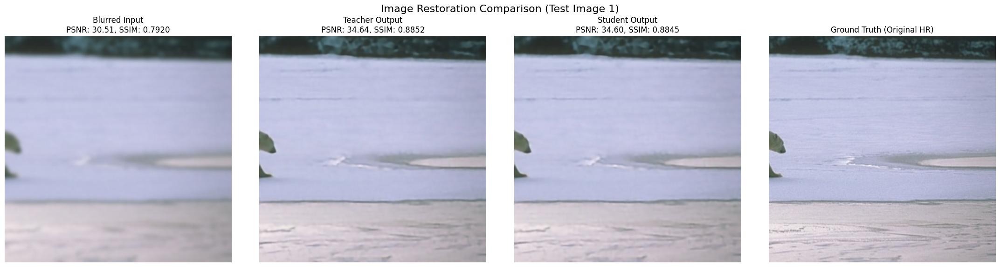

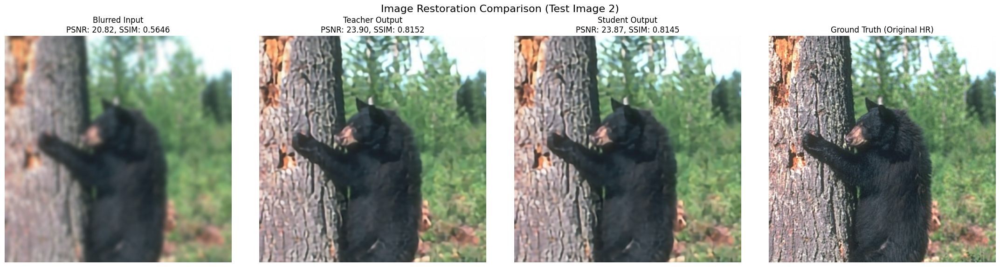

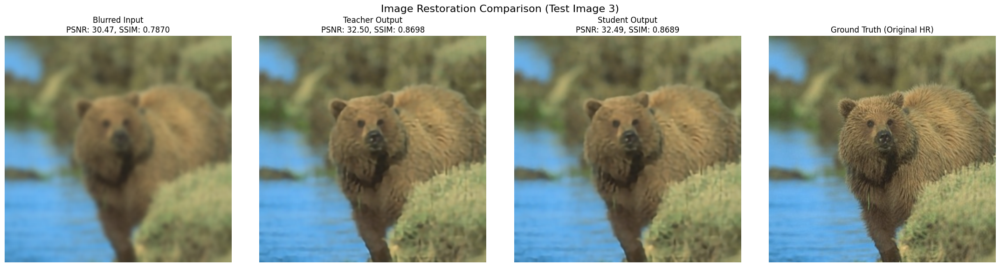

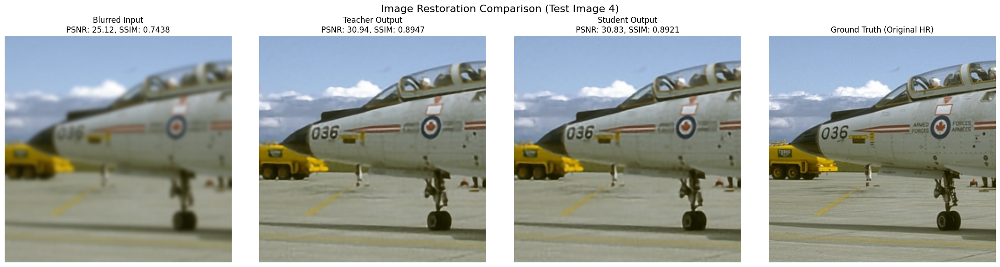

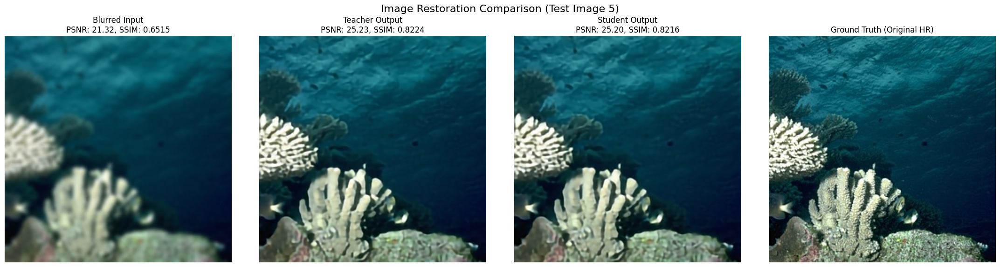

...

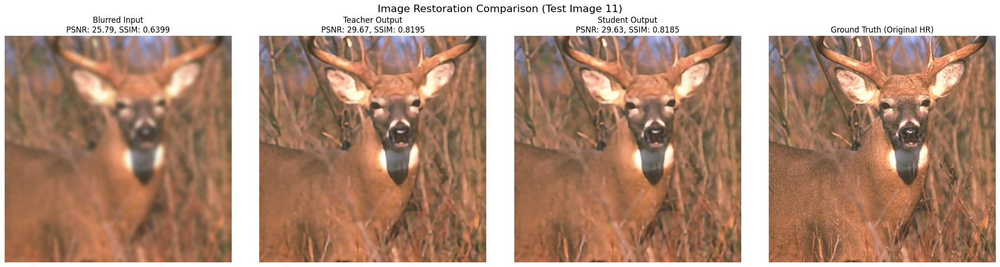

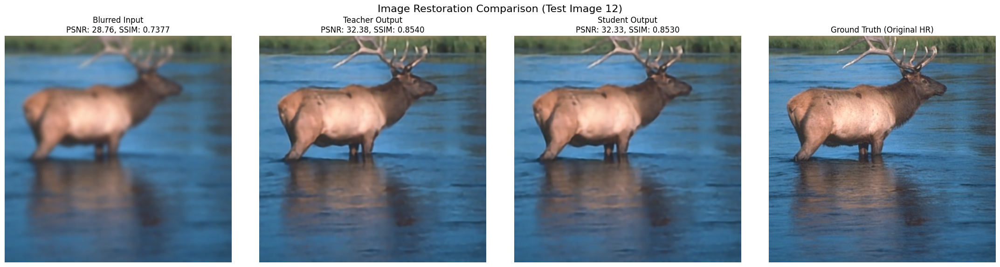

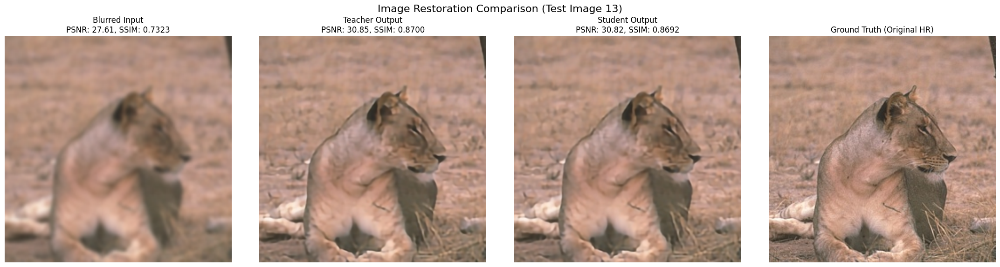

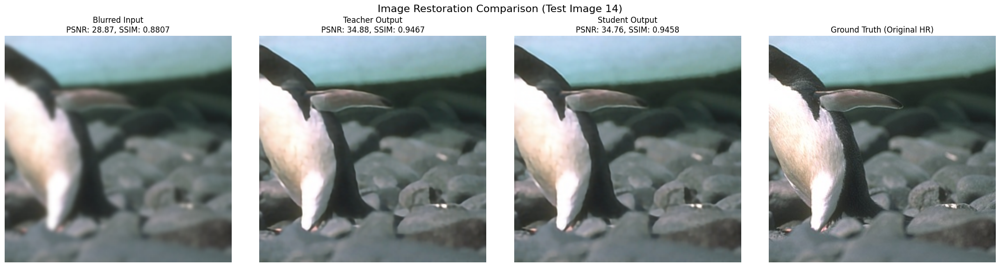

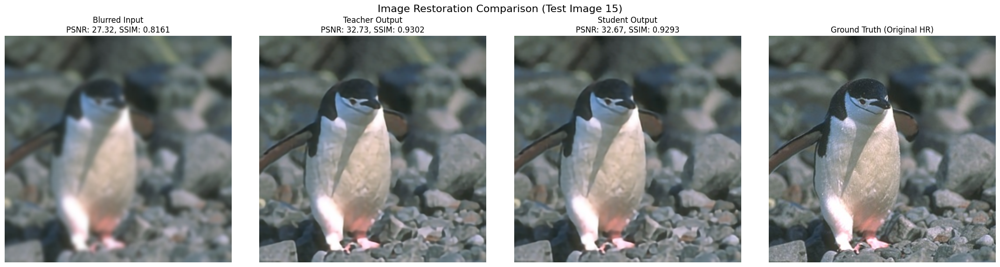

In [ ]:
# Cell 7: Evaluation and Visualization (MODIFIED TO SHOW MULTIPLE IMAGES)
print("\n--- Evaluating Models and Visualizing Final Results ---")
test_dataset = BSD500RestorationDataset(TEST_PATH, scale_factor=2, blur_radius=1)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

results = []
num_eval_images = 20

# Ensure models are in eval mode
teacher_model.eval()
student_model.eval()

with torch.no_grad():
    for i, batch in enumerate(tqdm(test_loader, desc="Evaluating on Test Set", total=num_eval_images)):
        if i >= num_eval_images: break
        degraded, hr = batch['lr'].to(device), batch['hr'].to(device)
        teacher_out = teacher_model(degraded)
        student_out = student_model(degraded)
        results.append({
            'student_psnr': calculate_psnr(student_out, hr), 'student_ssim': calculate_ssim(student_out, hr),
            'teacher_psnr': calculate_psnr(teacher_out, hr), 'teacher_ssim': calculate_ssim(teacher_out, hr),
            'input_psnr': calculate_psnr(degraded, hr), 'input_ssim': calculate_ssim(degraded, hr),
            'images': {'input': degraded.cpu(), 'teacher': teacher_out.cpu(), 'student': student_out.cpu(), 'hr': hr.cpu()}
        })

# --- Calculate and Print Average Metrics ---
print("\n--- Average Metrics over 20 Test Images ---")
print(f"Input   | PSNR: {np.mean([r['input_psnr'] for r in results]):.2f} dB | SSIM: {np.mean([r['input_ssim'] for r in results]):.4f}")
print(f"Teacher | PSNR: {np.mean([r['teacher_psnr'] for r in results]):.2f} dB | SSIM: {np.mean([r['teacher_ssim'] for r in results]):.4f}")
print(f"Student | PSNR: {np.mean([r['student_psnr'] for r in results]):.2f} dB | SSIM: {np.mean([r['student_ssim'] for r in results]):.4f}")

# --- Visualize the first N results ---
num_images_to_visualize = 15
print(f"\n--- Visualizing First {num_images_to_visualize} Test Images ---")

for i in range(min(num_images_to_visualize, len(results))):
    current_result = results[i]

    # Convert tensors to numpy images for plotting
    images_to_plot = {k: to_numpy_image(v) for k, v in current_result['images'].items()}

    # Create the plot
    fig, axes = plt.subplots(1, 4, figsize=(22, 6))

    # Define titles for this specific result
    titles = [
        f"Blurred Input\nPSNR: {current_result['input_psnr']:.2f}, SSIM: {current_result['input_ssim']:.4f}",
        f"Teacher Output\nPSNR: {current_result['teacher_psnr']:.2f}, SSIM: {current_result['teacher_ssim']:.4f}",
        f"Student Output\nPSNR: {current_result['student_psnr']:.2f}, SSIM: {current_result['student_ssim']:.4f}",
        "Ground Truth (Original HR)"
    ]

    # Set titles and images
    for ax, img_key, title in zip(axes, images_to_plot.keys(), titles):
        ax.imshow(images_to_plot[img_key])
        ax.set_title(title, fontsize=12)
        ax.axis('off')

    fig.suptitle(f"Image Restoration Comparison (Test Image {i+1})", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()